# 1. Import and Crop 3D Point Cloud

In [92]:
from plyfile import PlyData, PlyElement
import numpy as np
import copy
import plotly.graph_objects as go

def visualize_cloud(cloud, colors):
    fig = go.Figure(
        data=[
            go.Scatter3d(
                x=cloud[:,0], y=cloud[:,1], z=cloud[:,2], 
                mode='markers',
                marker=dict(size=1, color=colors)
            )
        ],
        layout=dict(
            scene=dict(
                xaxis=dict(visible=False),
                yaxis=dict(visible=False),
                zaxis=dict(visible=False)
            )
        )
    )
    fig.show()

file_path = f"/home/batman/Downloads/tdk_code/big_boxes/box_0/box_0_3.ply"

plydata = PlyData.read(file_path)
vertex_data = plydata['vertex']

cloud = np.column_stack((vertex_data['x'], vertex_data['y'], vertex_data['z']))
color = np.column_stack((vertex_data['red'], vertex_data['green'], vertex_data['blue']))

# Filter points based on the z value
crop_mask = cloud[:, 2] > 98.5

cloud_cropped = cloud[crop_mask]
color_cropped = color[crop_mask]

visualize_cloud(cloud_cropped, color_cropped)

# 2. Sample the Point Cloud Around the 2D LiDAR Illumination Plane

In [67]:
def within_thresh(point, thresh, point_on_plane, plane_normal):
    D = -np.dot(plane_normal, point_on_plane)
    distance = abs(np.dot(plane_normal, point) + D) / np.linalg.norm(plane_normal)
    return distance < thresh 

def export_to_ply(points, filename):
    with open(filename, 'w') as ply_file:
        # Write PLY header
        ply_file.write("ply\n")
        ply_file.write("format ascii 1.0\n")
        ply_file.write("element vertex {}\n".format(len(points)))
        ply_file.write("property float x\n")
        ply_file.write("property float y\n")
        ply_file.write("property float z\n")
        ply_file.write("end_header\n")

        # Write point coordinates
        for point in points:
            ply_file.write("{} {} {}\n".format(point[0], point[1], point[2]))

# 2D LiDAR Illumination plane parameter
orig = np.array([0.30740362, 0.91118271, 0.00581839])
plane_normal = [-9.502e+00,  1.090e+01,  2.910e-02]
thresh = 0.001 # in m

sampled_pts = np.array([point for point in cloud_cropped 
                     if within_thresh(point/1000, 0.001, orig, plane_normal)])

visualize_cloud(sampled_pts, None)

# 3. Project The Sampled Points onto a 2D Plane


In [68]:
mag = np.linalg.norm(plane_normal)

orig = orig * 1000 # turn to mm
normal_unit = plane_normal / mag

projected_points = []
for point in sampled_pts:
    v = point - orig
    dist = np.dot(v, normal_unit)
    projected_point = point - dist * normal_unit
    projected_points.append(projected_point)

# export the projected points to ply
export_to_ply(projected_points, "projected_pts2.ply")

# transform points on 3d plane to 2d plane
projected_pts = np.array(projected_points)

num_rows = projected_pts.shape[0]
np.random.seed(11)
random_idx = np.random.randint(0, num_rows)
random_idx2 = np.random.randint(0, num_rows)
u_pt = projected_pts[random_idx, :]

U = u_pt - orig
U = U / np.linalg.norm(U) # U normalized

V = np.cross(U, normal_unit)
V = V / np.linalg.norm(V) # V normalized

print(f"UN dot: {np.dot(U, normal_unit)}")
print(f"UV dot: {np.dot(U, V)}")
print(f"NV dot: {np.dot(normal_unit, V)}")

# The three principal vectors have to be normalized
print(np.linalg.norm(U))
print(np.linalg.norm(V))
print(np.linalg.norm(normal_unit))

#four basis points
u = orig + U
v = orig + V
n = orig + normal_unit
# orig itself

S = np.ones((4, 4))
S[0:3, 0] = orig
S[0:3, 1] = v
S[0:3, 2] = u
S[0:3, 3] = n

D = np.array([[0, 1, 0, 0],
            [0, 0, 1, 0],
            [0, 0, 0, 1],
            [1, 1, 1, 1]])

M = D @ np.linalg.inv(S)

projected_pts = [[x, y, z, 1] for x, y, z in projected_pts]
u_pt = np.append(u_pt, 1)
transformed_pts = projected_pts @ M.T

UN dot: 7.48099499014998e-17
UV dot: 0.0
NV dot: 2.7755575615628914e-17
0.9999999999999999
1.0
1.0


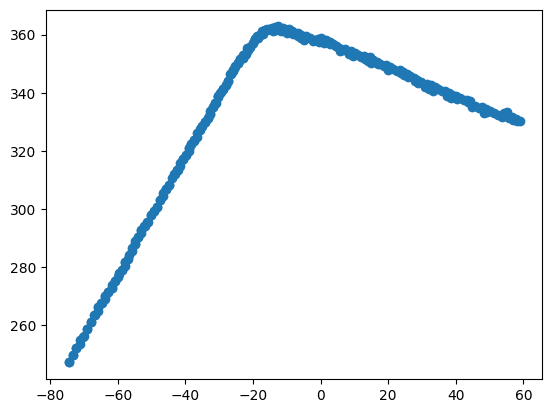

In [69]:
import matplotlib.pyplot as plt

plt.scatter(transformed_pts[:, 0], transformed_pts[:, 1])
plt.show()

# 4. Find the Orthogonal Vectors and Intersection Point fom RGBD Camera

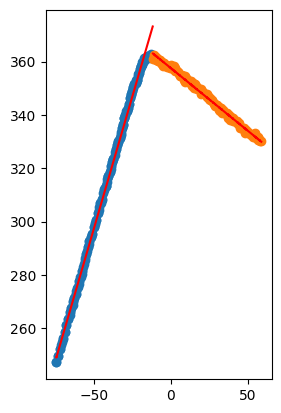

In [93]:
from sklearn.decomposition import PCA
import math

class Line:
    def __init__(self, a: float, b: float, c: float, inlier_points: list = []):

        self.a = a
        self.b = b
        self.c = c
        self.inlier_points = inlier_points

    def __str__(self):
        return f"a:{self.a} b:{self.b} c:{self.b}"

    def __repr__(self):
        return f"a:{self.a} b:{self.b} c:{self.b}"

    def get_line_explicit(self):
        return self.m, self.c

    def get_inlier_count(self):
        return len(self.inlier_points)

    def set_line(self, a, b, c):
        self.a = a
        self.b = b
        self.c = c


def sequential_ransac_multi_line_detection(
    data,
    threshold: float,
    min_points: int,
    max_iterations: int,
    max_lines: int,
    min_inliers: int = 5,
    min_points_cnt: int = 5,
    visualize: bool = False,
    subwindow: int = 1,
):

    best_lines = []
    remaining_data = data

    plt.subplot(1, 2, subwindow)
    for i in range(max_lines):

        best_line = ransac_line_detection(
            data=remaining_data,
            threshold=threshold,
            min_points=min_points,
            max_iterations=max_iterations,
        )

        # first stopping condition
        if best_line.get_inlier_count() <= min_inliers:
            break

        # perform PCA to inliers
        mean = np.mean(best_line.inlier_points, axis=0)
        points_centered = best_line.inlier_points - mean

        pca = PCA(n_components=2)
        pca.fit(best_line.inlier_points)

        v = pca.components_[0]

        a = v[1]
        b = -v[0]
        c = -a * mean[0] - b * mean[1]

        best_line.set_line(a, b, c)

        # accumulate the fitted line
        best_lines.append(best_line)

        # remove the inliers
        dtype = np.dtype(
            (np.void, (remaining_data.shape[1] * remaining_data.dtype.itemsize))
        )
        mask = np.in1d(remaining_data.view(dtype), best_line.inlier_points.view(dtype))
        remaining_data = remaining_data[~mask]

        # visualization
        if visualize:
            X = np.array(best_line.inlier_points)[:, 0]
            Y = np.array(best_line.inlier_points)[:, 1]

            Y_hat = (-a * X - c) / b

            # median_point = geometric_median(best_line.inlier_points)
            # plt.scatter(median_point[0], median_point[1], color="b")

            plt.scatter(X, Y)
            plt.plot(X, Y_hat, color="r")

        # second stopping condition
        if len(remaining_data) <= min_points_cnt:
            break

    return np.array(best_lines)


def ransac_line_detection(
    data,
    threshold: float,
    min_points: int,
    max_iterations: int,
) -> Line:

    best_num_inliers = None
    for i in range(max_iterations):
        # randomly select a subset of data points
        sample = data[np.random.choice(data.shape[0], 2, replace=False), :]

        # fit a line to the subset of data points
        x1, y1 = sample[0]
        x2, y2 = sample[1]

        a = y1 - y2
        b = x2 - x1
        c = x1 * y2 - x2 * y1

        distances = np.abs(a * data[:, 0] + b * data[:, 1] + c) / np.sqrt(
            a**2 + b**2
        )

        # count the number of inliers (data points that are within the threshold distance of the line)
        curr_num_inliers = (distances < threshold).sum()

        # If this line has more inliers than any previous line, update the best fit
        if best_num_inliers is None or curr_num_inliers > best_num_inliers:
            inlier_distances = np.abs(a * data[:, 0] + b * data[:, 1] + c) / np.sqrt(
                a**2 + b**2
            )
            inliers = data[inlier_distances < threshold]

            best_num_inliers = curr_num_inliers
            best_line_model = Line(a, b, c, inliers)

    return best_line_model

def find_connected_line_pair(detected_lines):

    best_inside_circle_cnt = 0
    for i in range(len(detected_lines)):
        for j in range(i + 1, len(detected_lines)):

            line1 = detected_lines[i]
            line2 = detected_lines[j]

            radius = 50
            center = find_intersection(line1, line2)

            inside_circle_cnt = 0

            for inlier_point in line1.inlier_points:
                if calc_dist_to_point(inlier_point, center) < radius:
                    inside_circle_cnt += 1

            for inlier_point in line2.inlier_points:
                if calc_dist_to_point(inlier_point, center) < radius:
                    inside_circle_cnt += 1

            if (
                inside_circle_cnt > best_inside_circle_cnt
                and angle_between_lines(line1, line2) > 85
            ):
                best_intersection = (detected_lines[i], detected_lines[j])
                best_inside_circle_cnt = inside_circle_cnt

    return best_intersection

def find_intersection(line1, line2):

    det = line1.a * line2.b - line2.a * line1.b

    # Check if the lines are parallel
    if np.abs(det) < 1e-6:
        return None

    x_int = (line1.b * line2.c - line2.b * line1.c) / det
    y_int = (line2.a * line1.c - line1.a * line2.c) / det

    return (x_int, y_int)

def calc_dist_to_point(point1, point2):

    x1, y1 = point1
    x2, y2 = point2
    dx = x2 - x1
    dy = y2 - y1
    return math.sqrt(dx * dx + dy * dy)

def angle_between_lines(line1, line2):

    L1 = [line1.a, line1.b, line1.c]
    L2 = [line2.a, line2.b, line2.c]

    vec1 = L1[:2]
    vec2 = L2[:2]

    dot_product = np.dot(vec1, vec2)

    mag_vec1 = np.linalg.norm(vec1)
    mag_vec2 = np.linalg.norm(vec2)

    # calculate the cosine of the angle between the vectors
    cos_angle = dot_product / (mag_vec1 * mag_vec2)

    # use arccosine to find the angle in radians
    angle_rad = np.arccos(cos_angle)

    # convert the angle to degrees
    angle_deg = math.degrees(
        angle_rad
        if angle_rad >= 0 and angle_rad <= math.pi / 2
        else math.pi - angle_rad
    )

    return angle_deg


points = np.array([[x, y] for x, y, z, n in transformed_pts])
detected_lines = sequential_ransac_multi_line_detection(
    points,
    threshold=3,
    min_points=2,
    max_iterations=1000,
    max_lines=2,
    visualize=True,
    subwindow=1,
)

coeff_matrix = np.array([[detected_lines[0].a, detected_lines[0].b], [detected_lines[1].a, detected_lines[1].b]])
constants_vector = np.array([-detected_lines[0].c, -detected_lines[1].c])
intersection_point = np.linalg.solve(coeff_matrix, constants_vector)

# 5. Find the Orthogonal Vectors and Intersection Point fom 2D LiDAR

[-1122.8678   -744.09174]


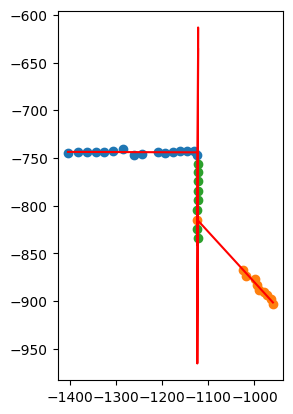

In [94]:
file_path = "/home/batman/Downloads/tdk_code/points_v.ply"
plydata = PlyData.read(file_path)
vertex_data = plydata['vertex']

x = vertex_data['x']
y = vertex_data['y']
z = vertex_data['z']

lidar_pts = np.column_stack((x, y, z))
lidar_pts_xy = lidar_pts[:, :2]

detected_lines2 = sequential_ransac_multi_line_detection(
    lidar_pts_xy,
    threshold=3,
    min_points=2,
    max_iterations=1000,
    max_lines=3,
    visualize=True,
    subwindow=1,
)

line_pair = find_connected_line_pair(detected_lines2)
coeff_matrix2 = np.array([[line_pair[0].a, line_pair[0].b], [line_pair[1].a, line_pair[1].b]])
constants_vector2 = np.array([-line_pair[0].c, -line_pair[1].c])
intersection_point2 = np.linalg.solve(coeff_matrix2, constants_vector2)
print(intersection_point2)

In [95]:
translation = intersection_point - intersection_point2
T = np.eye(3)
T[:2, 2] = translation 

original_point = np.append(intersection_point2, 1)
#res = T @ original_point
lidar_pts_xy1 = [[x, y, 1] for x, y in lidar_pts_xy]
homogenous_transformed_lidar_pts = lidar_pts_xy1 @ T.T

print(transformed_pts.shape)
homogenous_camera_pts = [[x, y, 1] for x, y, zero, one in transformed_pts]
export_to_ply(homogenous_camera_pts, "transformed_camera.ply")
export_to_ply(homogenous_transformed_lidar_pts, "transformed_lidar.ply")

(280, 4)


In [96]:
# vectors from the lidar points
vecs1 = line_pair[0].inlier_points - intersection_point2
vecs2 = line_pair[1].inlier_points - intersection_point2

# vectors from the camera points
vecs3 = detected_lines[0].inlier_points - intersection_point
vecs4 = detected_lines[1].inlier_points - intersection_point

def angle_between_vectors(v1, v2):
    dot_product = np.dot(v1, v2)
    norm_v1 = np.linalg.norm(v1)
    norm_v2 = np.linalg.norm(v2)
    if norm_v1 == 0 or norm_v2 == 0:
        raise ValueError("One or both vectors have zero length.")

    cos_theta = dot_product / (norm_v1 * norm_v2)
    angle_rad = np.arccos(np.clip(cos_theta, -1.0, 1.0))
    angle_deg = np.degrees(angle_rad)
    return angle_deg

def get_med_idx(vector_list):
    sorted_indices = np.argsort(vector_list)
    median_index = sorted_indices[len(sorted_indices) // 2]
    return median_index

# calculating vector angle in lidar points to target_vector1 (chosen randomly -- first one in this case)
target_vector1 = vecs1[0]
vecs1_angle = [angle_between_vectors(curr_vector, target_vector1) for curr_vector in vecs1]
vecs2_angle = [angle_between_vectors(curr_vector, target_vector1) for curr_vector in vecs2]

# getting the median vector
vecs1_med = vecs1[get_med_idx(vecs1_angle)]
vecs2_med = vecs2[get_med_idx(vecs2_angle)]

# calculating vector angle in camera points to target_vector2 (chosen randomly -- first one in this case)
target_vector2 = vecs3[0]
vecs3_angle = [angle_between_vectors(curr_vector, target_vector2) for curr_vector in vecs3]
vecs4_angle = [angle_between_vectors(curr_vector, target_vector2) for curr_vector in vecs4]

# getting the median vector
vecs3_med = vecs3[get_med_idx(vecs3_angle)]
vecs4_med = vecs4[get_med_idx(vecs4_angle)]

# 6. Transform the 2D LiDAR Point to RGBD Point Cloud

In [97]:
def gram_schmidt_2d(v1, v2):
    # Convert the input vectors to numpy arrays
    v1, v2 = np.array(v1), np.array(v2)
    
    # Subtract the projection of v2 onto v1
    v2 = v2 - np.dot(v1, v2) / np.dot(v1, v1) * v1
    
    # Normalize v1 and v2
    v1 /= np.linalg.norm(v1)
    v2 /= np.linalg.norm(v2)
    
    return v1, v2

vec1_ortho, vec2_ortho = gram_schmidt_2d(vecs1_med, vecs2_med)
vec3_ortho, vec4_ortho = gram_schmidt_2d(vecs3_med, vecs4_med)

# load lidar point cloud to transform (comment to use the line-detected lidar points)
file_path = "/home/batman/ws/points_v.ply"
plydata = PlyData.read(file_path)
vertex_data = plydata['vertex']

x = vertex_data['x']
y = vertex_data['y']
z = vertex_data['z']

lidar_pts = np.column_stack((x, y, z))
lidar_pts_xy = lidar_pts[:, :2]

# apply only rotation
rotation_matrix = [[vec3_ortho @ vec1_ortho, vec4_ortho @ vec1_ortho],
                  [vec3_ortho @ vec2_ortho, vec4_ortho @ vec2_ortho]]

T = np.eye(3)
T[:2, :2] = rotation_matrix

transformed_lidar_pts = lidar_pts_xy - intersection_point2
transformed_lidar_xy1 = [[x, y, 1] for x, y in transformed_lidar_pts]
homogenous_transformed_lidar_pts = transformed_lidar_xy1 @ T.T

# final translation back to merge the lidar pointcloud with the camera
translation1 = intersection_point - intersection_point2
translation2 = intersection_point2
total_trans = translation1 + translation2

T = np.eye(3)
T[:2, 2] = total_trans 
final_trans_pts_2d = homogenous_transformed_lidar_pts @ T.T

# affine transform back to 3d

final_trans_pts_2d01 = np.array([[x, y, 0, 1] for x, y, one in final_trans_pts_2d]) 
m_inv = np.linalg.inv(M)
final_pts_3d = final_trans_pts_2d01 @ m_inv.T

export_pts = final_pts_3d[:, :3]
# transformation to the original plane in 3d
export_to_ply(export_pts, "transformed_lidar_v.ply")

In [98]:
export_pts_colors = np.vstack([[0, 0, 255]] * len(export_pts))

merged_colors = np.vstack((color, export_pts_colors))
merged_cloud = np.vstack((cloud, export_pts))

visualize_cloud(merged_cloud, merged_colors)